## Network generation and visualization

In [363]:
import datetime
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import math
from random import sample
from IPython.display import display 
import statistics as stat
from collections import Counter

from sklearn import preprocessing
le = preprocessing.LabelEncoder()

In [364]:
print('The test time: ',datetime.datetime.now())

The test time:  2021-03-03 13:59:51.214539


In [365]:
links=pd.read_csv('edge.csv')
nodes=pd.read_csv('node.csv')


# display df and check null
display(links.head(5))
print('Contains null =',links.isnull().values.any())
display(nodes.head(5))
print('Contains null =',nodes.isnull().values.any())

,source,target
0,abdomen,pelvis
1,abdomen,pelvis
2,abdomen,pelvis
3,abdomen,pelvis
4,abdomen,pelvis


Contains null = False


,name,nodesize,group
0,abdomen,494,ORGAN
1,patient,567,ORGANISM
2,esophagus,311,ORGAN
3,biopsies,178,CANCER
4,gallbladder,204,ORGAN


Contains null = False


In [366]:
le.fit(nodes.group)

nodes['group']=le.transform(nodes.group)*2

In [367]:
def add_weight_link(links):
    
    def link_weight(links):
        t=links.groupby(links.columns.tolist(),as_index=False).size()
        values=t.values
        t_df=pd.DataFrame(list(t.index),columns=['n1','n2'])
        t_df['values']=values
        return t_df

    link_w=link_weight(links)

    link_s=links.source
    link_t=links.target
    links_reverse=pd.DataFrame(np.column_stack([link_t, link_s]), 
                               columns=['target', 'source'])

    link_w_r=link_weight(links_reverse)

    count=[]
    s=[]
    t=[]
    for i in link_w.index:
        for j in link_w_r.index:
            if (link_w.n1[i]==link_w_r.n1[j]) and (link_w.n2[i]==link_w_r.n2[j]):
                values=link_w['values'][i]+link_w_r['values'][j]
                count.append(values)
                s.append(link_w.n1[i])
                t.append(link_w.n2[i])

    overlap=pd.DataFrame(np.column_stack([s,t,count]), columns=['n1','n2','count'])

    for i in link_w.index:
        for j in overlap.index:
            if (link_w.n1[i]==overlap.n1[j]) and (link_w.n2[i]==overlap.n2[j]):
                link_w['values'][i]=overlap['count'][j]

    link_w.columns=['source','target','value']
    return link_w

In [368]:
links=add_weight_link(links)
links.head()

<ipython-input-367-af0b9aae5d37>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  link_w['values'][i]=overlap['count'][j]


,source,target,value
0,abdomen,abdominal,3
1,abdomen,abdominal wall,6
2,abdomen,adrenal glands,34
3,abdomen,alcohol,3
4,abdomen,anterior abdominal wall,6


In [369]:
# num of nodes and edges
num_links=len(links)
num_nodes=len(nodes)

print('Number of nodes =',num_nodes)
print('Number of links =', num_links)

Number of nodes = 163
Number of links = 621


Text(0.5, 0, 'Node Size')

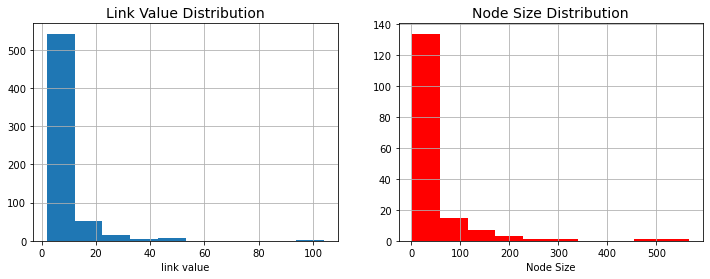

In [370]:
# plot the histogram of the link value and node size
figsize=(12,4)
fig, (ax1, ax2) = plt.subplots(1, 2,figsize=figsize)
fontsize=14

plt.subplot(1, 2, 1)
ax1=links.value.hist()
ax1.set_title('Link Value Distribution',fontsize=fontsize)
ax1.set_xlabel('link value')
ax1.plot()

plt.subplot(1, 2, 2)
ax2=nodes.nodesize.hist(color='red')
ax2.set_title('Node Size Distribution',fontsize=fontsize)
ax2.set_xlabel('Node Size')

In [371]:
# function for bar plot with numerical label
def bar_plt(figsize,title,width,x,y,xlabel,ylabel):
    fig, ax = plt.subplots(figsize=figsize)
    # set title
    ax.set_title(title,fontsize=16)
    # set x axis label location
    x_loc=np.arange(len(x))
    ax.set_xticks(x_loc)
    # height
    height=list(y)
    # bar rectangle
    rect = ax.bar(x, height, width,color='Lightblue')
    # set x and y label
    ax.set_ylabel(ylabel,fontsize=12)
    ax.set_xlabel(xlabel,fontsize=12)
    # set the text for each rect
    for j in range(len(x_loc)):
        ax.text(x_loc[j],height[j],str(height[j]),ha='center')

In [372]:
hot_tag=nodes.nlargest(5, ['nodesize'])

tag_name=list(hot_tag['name'])
tag_pop=list(hot_tag['nodesize'])

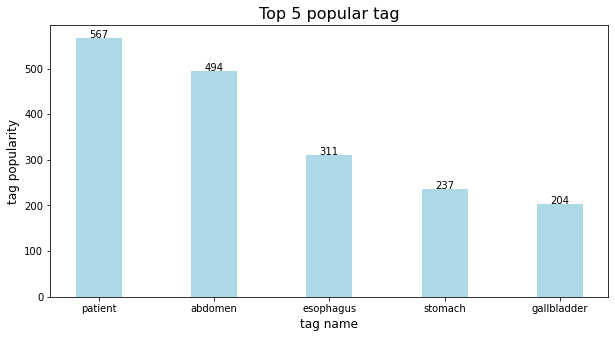

In [373]:
# node grpup cout bar plot
bar_plt(figsize=(10,5),
        title='Top 5 popular tag',
        width=0.4,
        x=tag_name,
        y=tag_pop,
        xlabel='tag name',
        ylabel='tag popularity')

In [374]:
# node size
node_size=nodes['nodesize']
# adjust the value for better display
node_size=pd.Series(node_size).array*100
node_size=list(node_size)

print(type(node_size))
print('check length: ',len(node_size)==len(nodes))

<class 'list'>
check length:  True


In [375]:
node_size[1]

56700

In [376]:
#set color for graph
# color = nodes['group']
colors=nodes['group']
colors=colors.values

print(type(colors))
print('check length: ',len(colors)==len(nodes))

<class 'numpy.ndarray'>
check length:  True


In [377]:
# links['value'] = widths * constant
base=1.1
widths=links['value']
widths=widths/min(widths)
widths=base**widths
widths=list(widths.values)

print(type(widths))
print('check length: ',len(widths)==len(links))

<class 'list'>
check length:  True


In [378]:
# function to generate weighted edges from edges dataframe
def edge_weight_gen(link):
    edges=[]
    for i in range(len(link)):
        edge=(link['source'][i],link['target'][i],link['value'][i])
        edges.append(edge)
    print('check length: ',len(edges)==len(link))
    return edges

In [379]:
edges=edge_weight_gen(links)

check length:  True


In [380]:
G= nx.Graph()
G.add_weighted_edges_from(edges)
pos = nx.layout.spring_layout(G,k=0.8)

print('check length: ',len(G.edges())==len(links))
print(type(G))

check length:  False
<class 'networkx.classes.graph.Graph'>


In [381]:
# labels
nodelist=nodes['name']
labels=dict(zip(nodelist,nodelist))
print('type of labels: ',type(labels))

type of labels:  <class 'dict'>


In [382]:
# sample edge to convert the data type
sample_edges=sample(G.edges,5)
print(sample_edges)

# view the edge attributes
G.edges[sample_edges[0]]

[('mucosa', 'gastric pouch'), ('small bowel', 'pouch'), ('urine', 'glucose'), ('abdominal wall', 'skin'), ('patient', 'midline')]


{'weight': 2}

In [383]:
def draw_graph(figsize,pos,G,node_size,title): # labels could choose 'None'
    fig = plt.figure(figsize=figsize)
    pos=pos
    G=G
    node_size=node_size
    
    nx.draw_networkx_nodes(G,
                           pos,
                           node_size=node_size,
                           node_color=colors,
                           alpha=1)
    
    nx.draw_networkx_edges(G,
                           pos,
                           edge_color='r',
                           width=widths,
                           alpha=0.9)
    
    nx.draw_networkx_labels(G, 
                            pos,
                            labels=labels,
                            font_color='blue',
                            font_size=100,
                            alpha=1,
                            verticalalignment='top')
    plt.title(title,fontsize=80,color='blue')

In [384]:
draw_graph(figsize=(200,200),
           pos=pos,
           G=G,
           node_size=node_size,
          title='Whole network view')

In [385]:
# average degree of graph
degrees=[G.degree(n) for n in G.nodes()]
average_degree=stat.mean(degrees)
print('the average_degree =',average_degree)

the average_degree = 6.785276073619632


<BarContainer object of 26 artists>

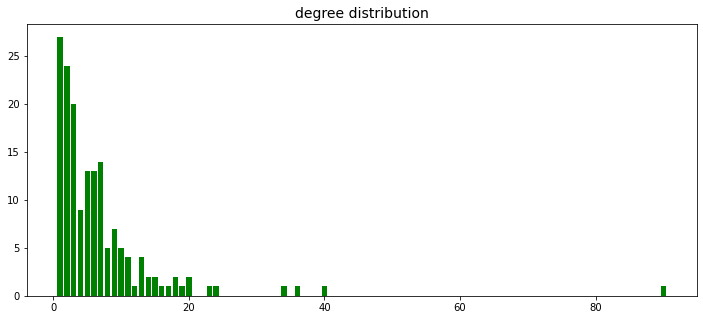

In [386]:
degrees_counter=Counter(degrees)
# The zip() function returns a zip object, which is an iterator of tuples where the first item in each passed iterator is paired together, 
# and then the second item in each passed iterator are paired together etc.
degrees,degrees_frequency=zip(*degrees_counter.items())
degrees=list(degrees)

degrees_frequency=list(degrees_frequency)

fig, ax = plt.subplots(figsize=(12,5))
# set title
ax.set_title('degree distribution',fontsize=14)
plt.bar(degrees,degrees_frequency,
        color='green')

In [387]:
def top_centrality_nodes(degree_cnt):
    dict_items=degree_cnt.items()
    dict_items_sorted=sorted(dict_items,key=lambda item:item[1],reverse=True)
    
    degree_cnt_sorted={k:v for k,v in dict_items_sorted}
    most_impt_nodes=list(degree_cnt_sorted)[:10]
    
    return most_impt_nodes

# function to plot the top centrality nodes
def top_cnt_plot(degree_cnt,cent_type):
    dict_items=degree_cnt.items()
    dict_items_sorted=sorted(dict_items,key=lambda item:item[1],reverse=True)
    # plot the bar chart for the top cnt tags
    top_10_tag=dict_items_sorted[:10]
    top_tag=[]
    top_cnt=[]
    for tag in top_10_tag:
        top_tag.append(tag[0])
        top_cnt.append(tag[1])
        
    fig = plt.figure(figsize=(11,4))
    plt.title('The top 10 '+cent_type+'-centrality nodes',fontsize=14)
    plt.bar(top_tag,top_cnt,color='blue')
    # plot end

In [388]:
degree_cnt_load=nx.load_centrality(G)
print('top 10 load degree centrality\n',top_centrality_nodes(degree_cnt_load))
impt_nodes_load=top_centrality_nodes(degree_cnt_load)

top 10 load degree centrality
 ['patient', 'abdomen', 'stomach', 'esophagus', 'gallbladder', 'anterior', 'colon', 'area', 'skin', 'rectum']


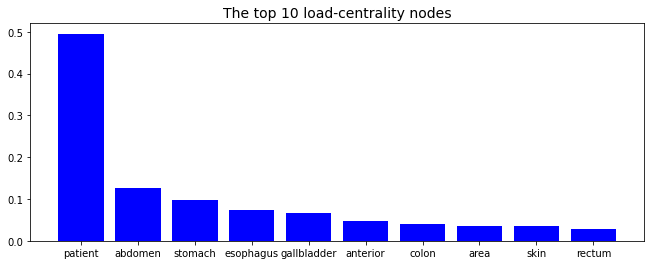

In [389]:
top_cnt_plot(degree_cnt=degree_cnt_load,
             cent_type='load')

In [390]:
# create dic for top 10 tag labels ---  for highlight purpose
def impt_labels(impt_nodes,G):
    impt_labels={}
    for node in G.nodes():
        if node in impt_nodes:
            #set the node name as the key and the label as its value 
            impt_labels[node] = node
    return impt_labels

In [391]:
impt_labels_load=impt_labels(impt_nodes_load,G)

In [392]:
def draw_graph_cnt(figsize,pos,graph,node_size,node_list,select_label,title): # labels could choose 'None'
    fig = plt.figure(figsize=figsize)
    pos=pos
    G=graph
    select_label=select_label
    nodelist=node_list
    
    nx.draw_networkx_nodes(G,
                           pos,
                           node_size=node_size,
                           node_color=colors,
                           alpha=1)
    
    nx.draw_networkx_nodes(G,
                           pos,
                           node_color='yellow',
                           node_size=30000,
                           nodelist=nodelist,
                           alpha=1)
    
    nx.draw_networkx_edges(G,
                           pos,
                           edge_color='r',
                           width=widths,
                           alpha=0.8)
     
    nx.draw_networkx_labels(G, 
                            pos,
                            labels=select_label,
                            font_color='blue',
                            font_size=45,
                            alpha=1,
                            verticalalignment='top')
    plt.title(title,fontsize=65,color='blue')
    


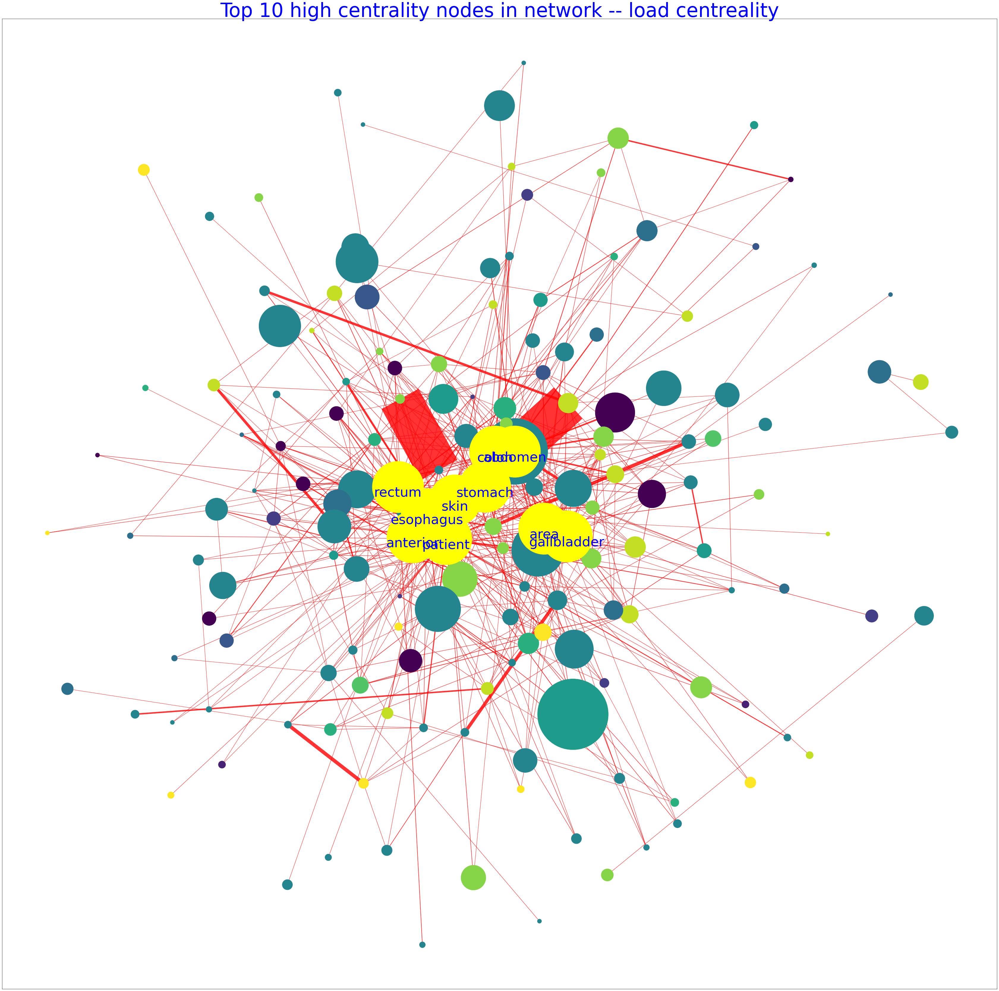

In [393]:
draw_graph_cnt(figsize=(60,60),
               pos=pos,
               graph=G,
               node_size=node_size,
               node_list=impt_nodes_load,
               select_label=impt_labels_load,
               title='Top 10 high centrality nodes in network -- load centreality')

In [394]:
def related_subgraph(select_node):
    subnodes=[]
    for source,target in G.edges:
        if source==select_node:
            subnodes.append(target)
            #print(target)
        if target==select_node:
            subnodes.append(source)
            #print(source)
        subnodes.append(select_node)
    subnodes=list(set(subnodes))
    subgraph= G.subgraph(subnodes)
    return subgraph

In [395]:
interest_tags=['patient', 'abdomen', 'stomach', 'esophagus', 'gallbladder', 'stomach', 
               'colon', 'rectum','female','abdominal wall','duodenum']
sub_G_name=['G_pat','G_abd','G_sto','G_eso','G_gal','G_ant','G_col','G_rec',
            'G_fel','G_abdw','G_duo']
sub_G_list=[]
for i in range(len(interest_tags)):
    tag=interest_tags[i]
    sub_G_list.append(related_subgraph(tag))
    
sub_G_dic=dict(zip(sub_G_name,sub_G_list))

In [396]:
sub_G_dic

{'G_pat': <networkx.classes.graph.Graph at 0x7fe2050a3c10>,
 'G_abd': <networkx.classes.graph.Graph at 0x7fe2050a35e0>,
 'G_sto': <networkx.classes.graph.Graph at 0x7fe2050a31c0>,
 'G_eso': <networkx.classes.graph.Graph at 0x7fe2050a31f0>,
 'G_gal': <networkx.classes.graph.Graph at 0x7fe2050a3a90>,
 'G_ant': <networkx.classes.graph.Graph at 0x7fe2050a3b80>,
 'G_col': <networkx.classes.graph.Graph at 0x7fe2050a3d90>,
 'G_rec': <networkx.classes.graph.Graph at 0x7fe2050a3d60>,
 'G_fel': <networkx.classes.graph.Graph at 0x7fe2050a3f10>,
 'G_abdw': <networkx.classes.graph.Graph at 0x7fe2050a3dc0>,
 'G_duo': <networkx.classes.graph.Graph at 0x7fe20507fdf0>}

In [397]:
# function take input name of graph, the name of interest rate tag
# e.g. 
# int_graph='G_py'
# int_tag_name='python'

def plot_int_tag_graph(int_graph,int_tag_name):
    # access the G_int
    G_int=sub_G_dic[int_graph]

    # width of the G_int
    def width_gen(G_int):
        # width of the G_int
        base=5
        width=nx.get_edge_attributes(G_int, 'weight')
        width=list(width.values())
        width=width/min(width)
        width=base*width
        return width
    width=width_gen(G_int)

    # function to extract nodes df for G_int
    def int_node_df(G_int):
        int_nodes=list(G_int.nodes)
        int_df=nodes[nodes['name'].isin(int_nodes)]
        return int_df
    int_df=int_node_df(G_int)


    # dict for assign attributes to the node (group and nodesize)
    int_node_dict=int_df.set_index('name').to_dict(orient='index')

    # set the network node attributes
    nx.set_node_attributes(G_int,int_node_dict)
    nx.get_node_attributes(G_int,'group')

    # get node size 
    int_node_size=list(nx.get_node_attributes(G_int,'nodesize').values())
    int_node_size=pd.Series(int_node_size).array*20

    # get node color
    int_node_color=list(nx.get_node_attributes(G_int,'group').values())

    # use func to create dict for all labels
    int_labels=impt_labels(list(G_int.nodes),G_int)
    
    def draw_graph_int(figsize,k,graph,node_size,node_color,node_int,edge_width,label,title): # labels could choose 'None'
        fig = plt.figure(figsize=figsize)
        G=graph
        label=label
        node_int=list(node_int)
        pos = nx.layout.spring_layout(G,k)

        nx.draw_networkx_nodes(G,
                               pos,
                               node_size=node_size,
                               node_color=node_color,
                               alpha=1)

        nx.draw_networkx_nodes(G,
                               pos,
                               node_color='red',
                               nodelist=node_int,
                               alpha=1)

        nx.draw_networkx_edges(G,
                               pos,
                               edge_color='blue',
                               width=edge_width,
                               alpha=0.1)

        nx.draw_networkx_labels(G, 
                                pos,
                                labels=label,
                                font_color='red',
                                font_size=35,
                                alpha=1,
                                verticalalignment='bottom')
        plt.title(title,fontsize=60,color='blue')

    # draw the graph
    fig=draw_graph_int(figsize=(50,40),
                       k=0.1,
                       graph=G_int,
                       node_size=int_node_size,
                       node_color=int_node_color,
                       node_int=[int_tag_name],
                       edge_width=width,
                       label=int_labels,
                       title=int_graph+' Network')


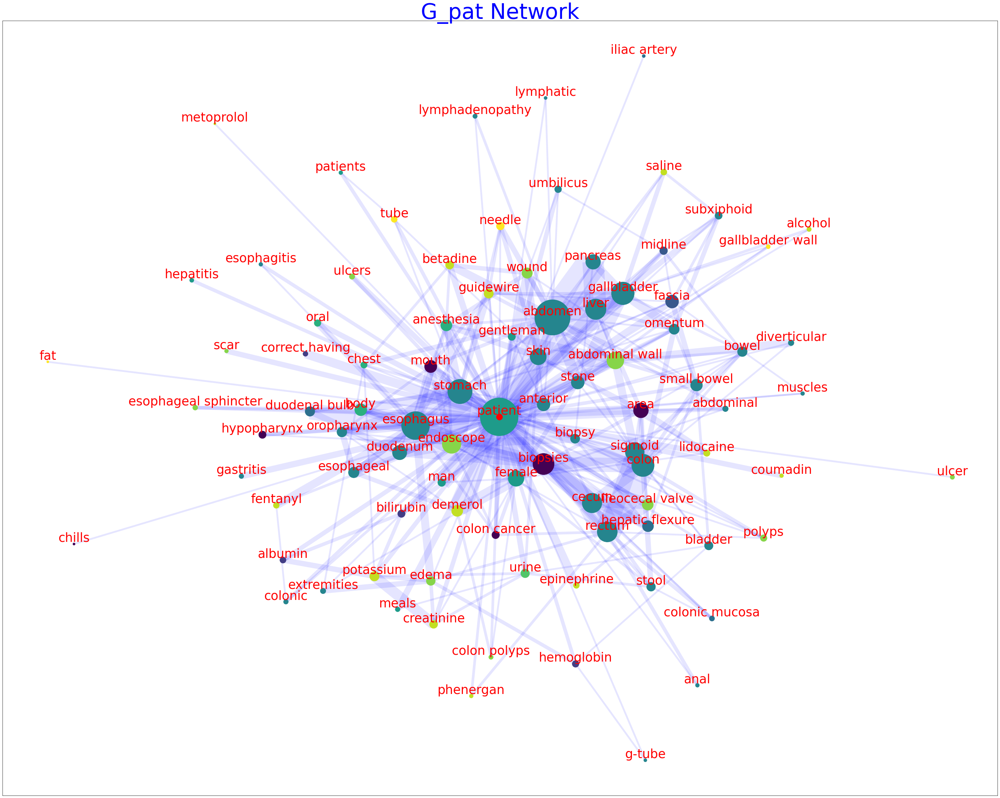

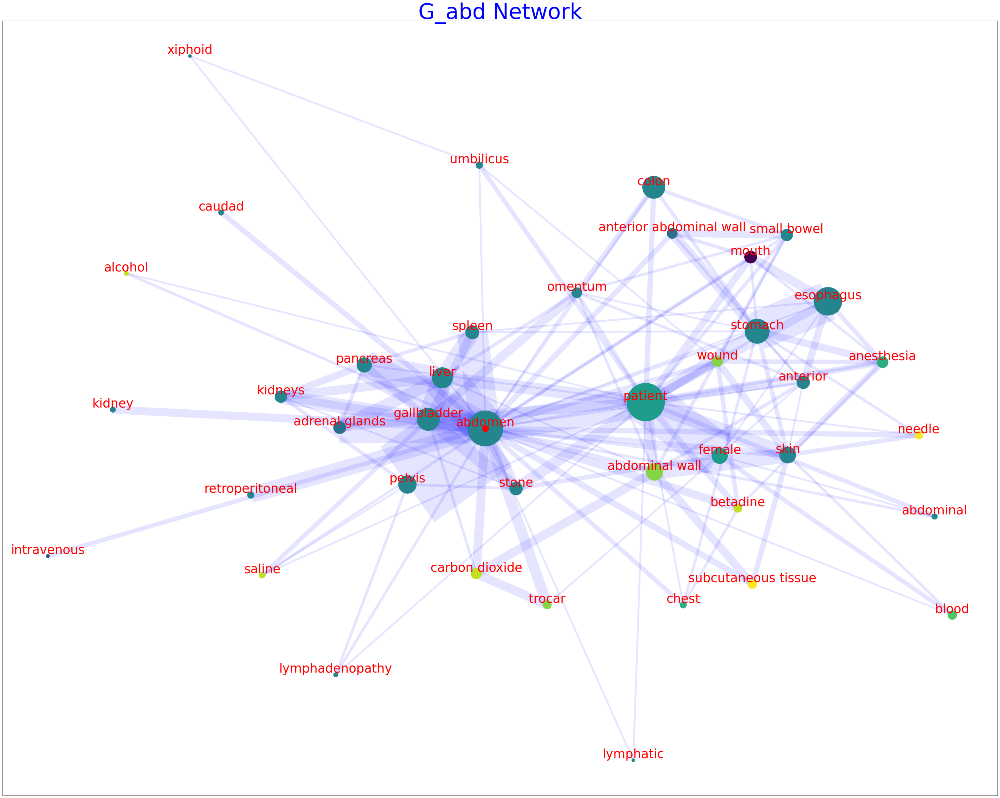

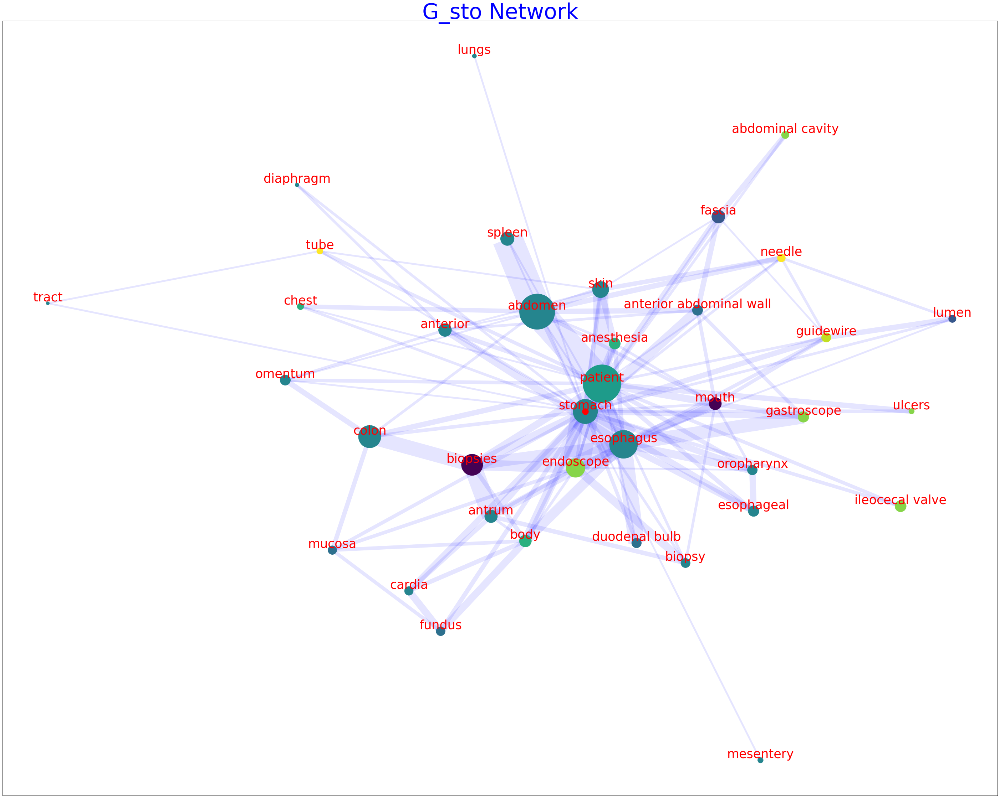

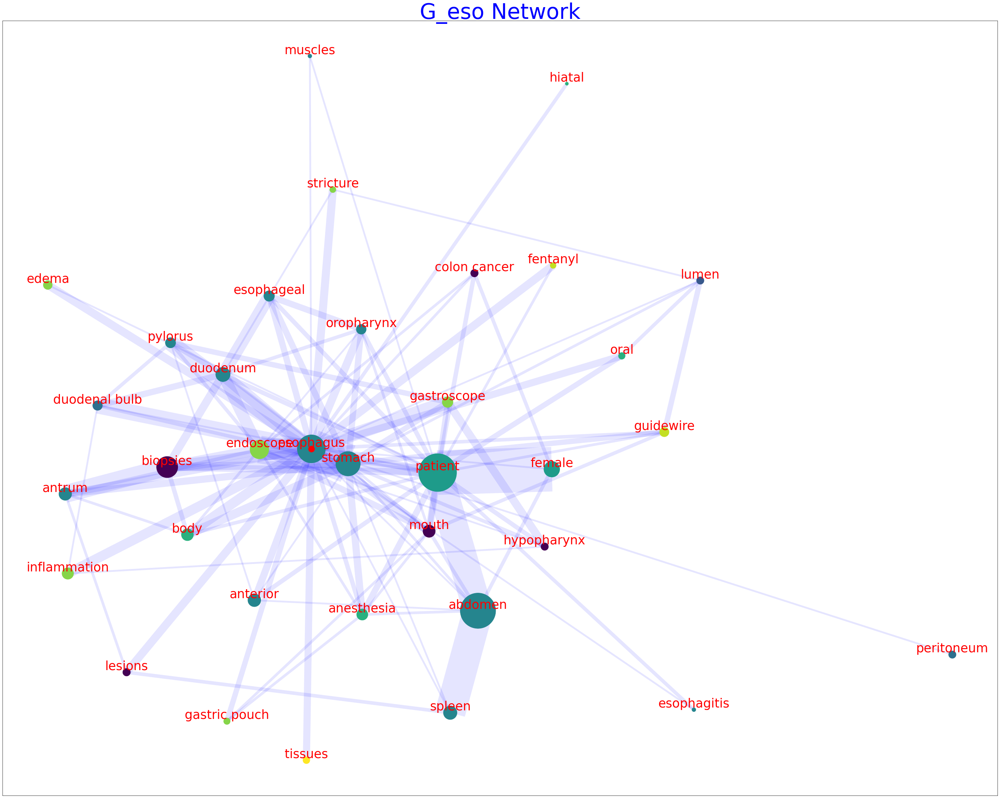

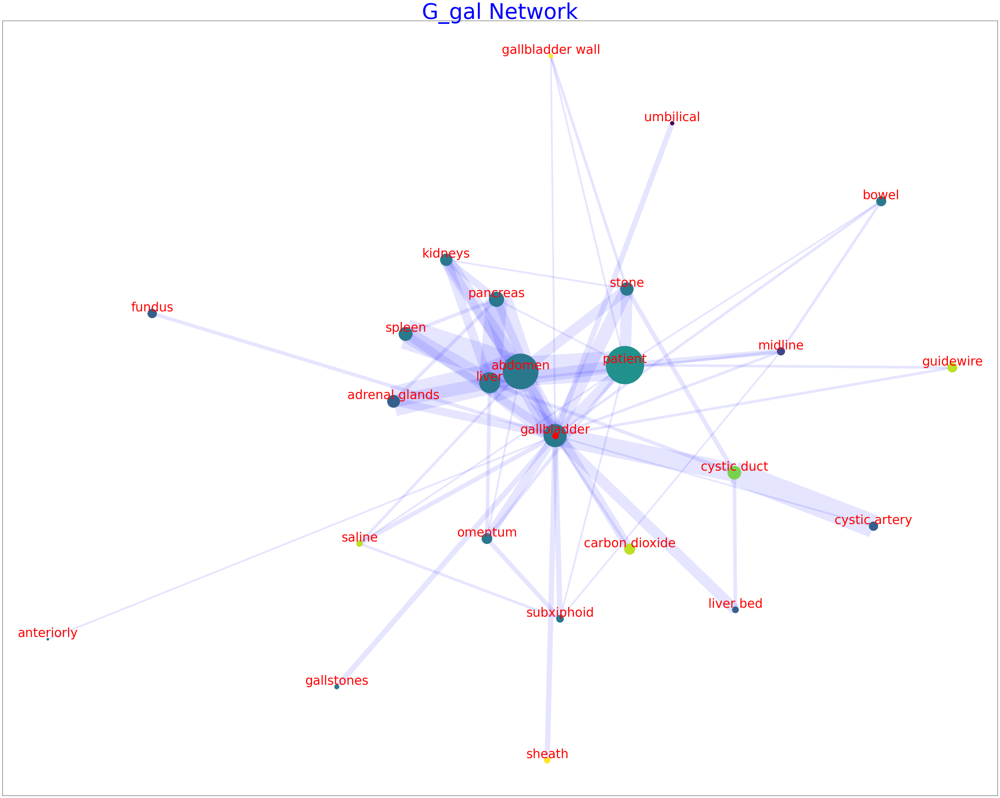

...

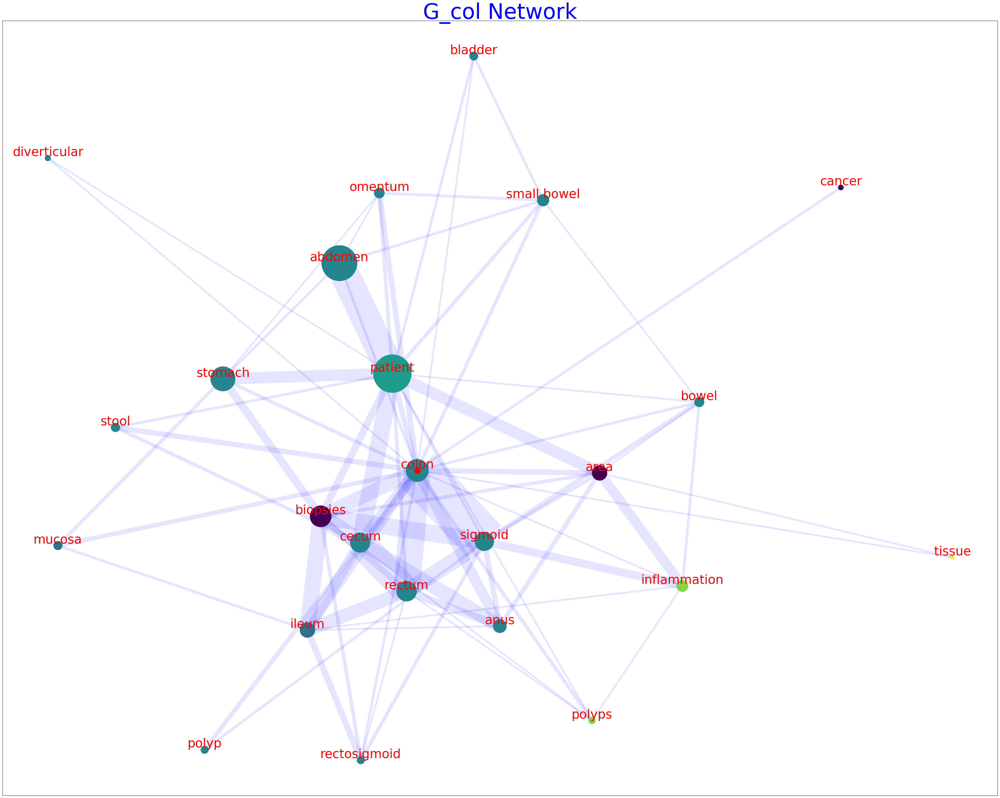

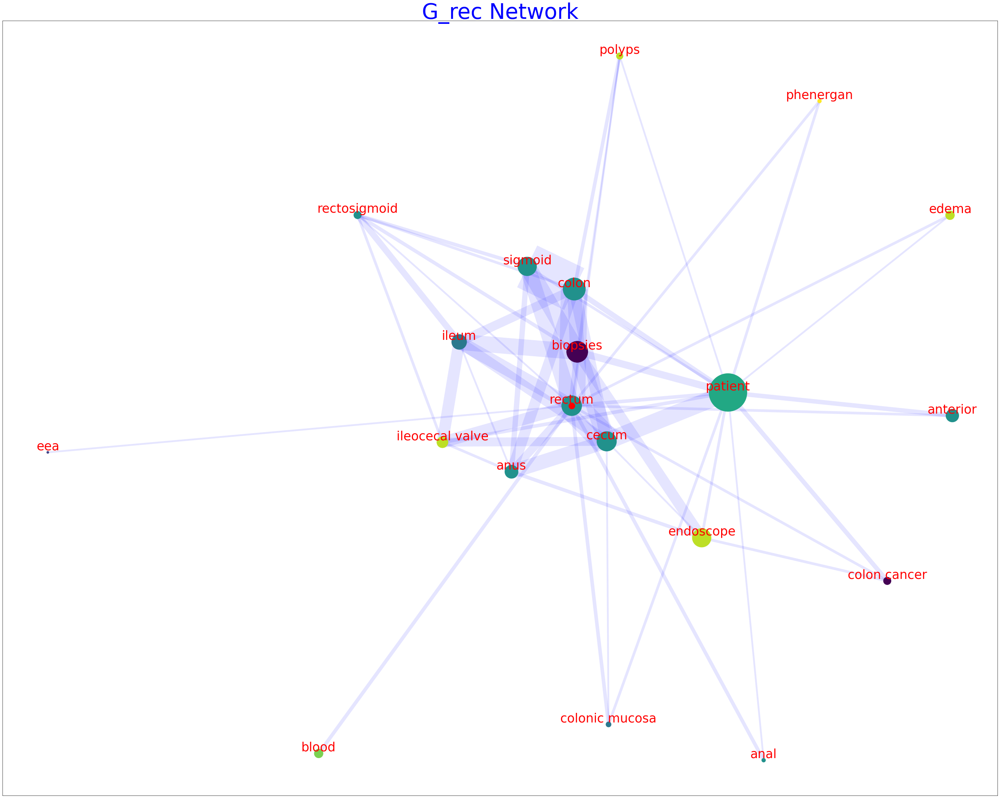

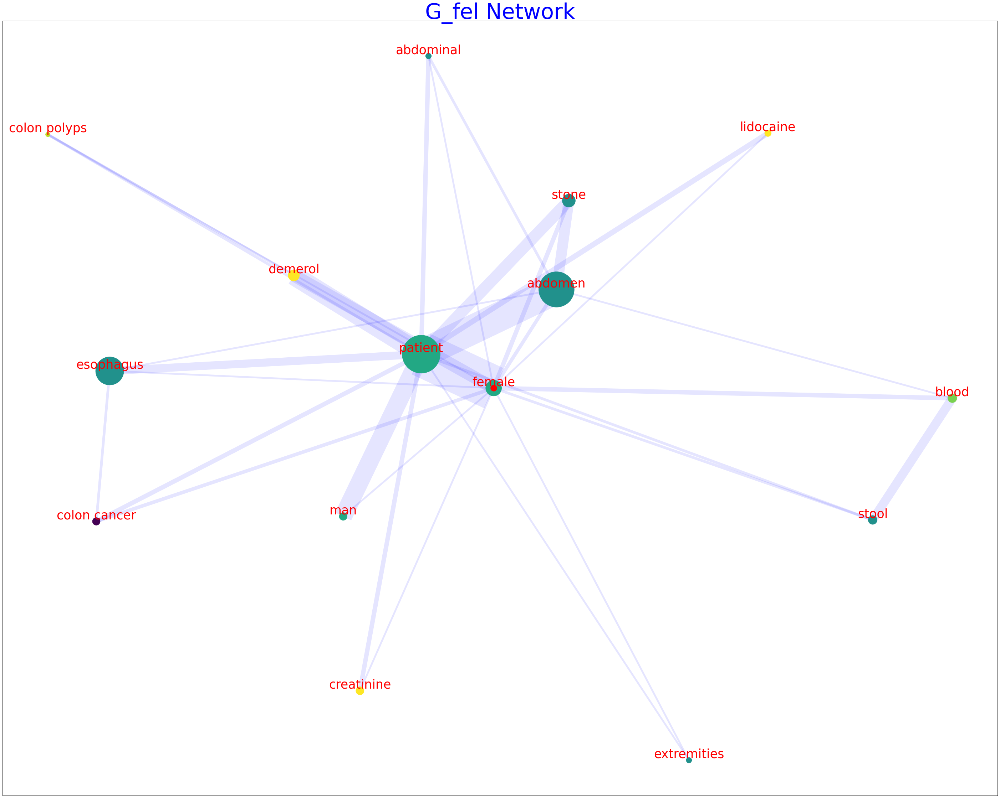

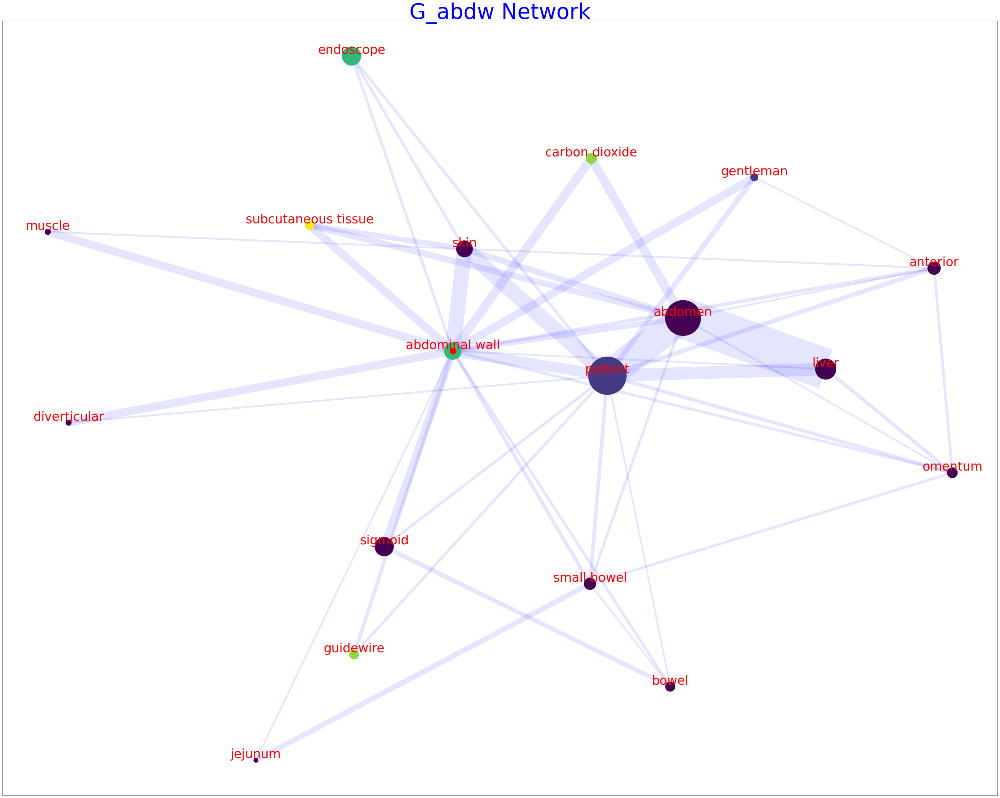

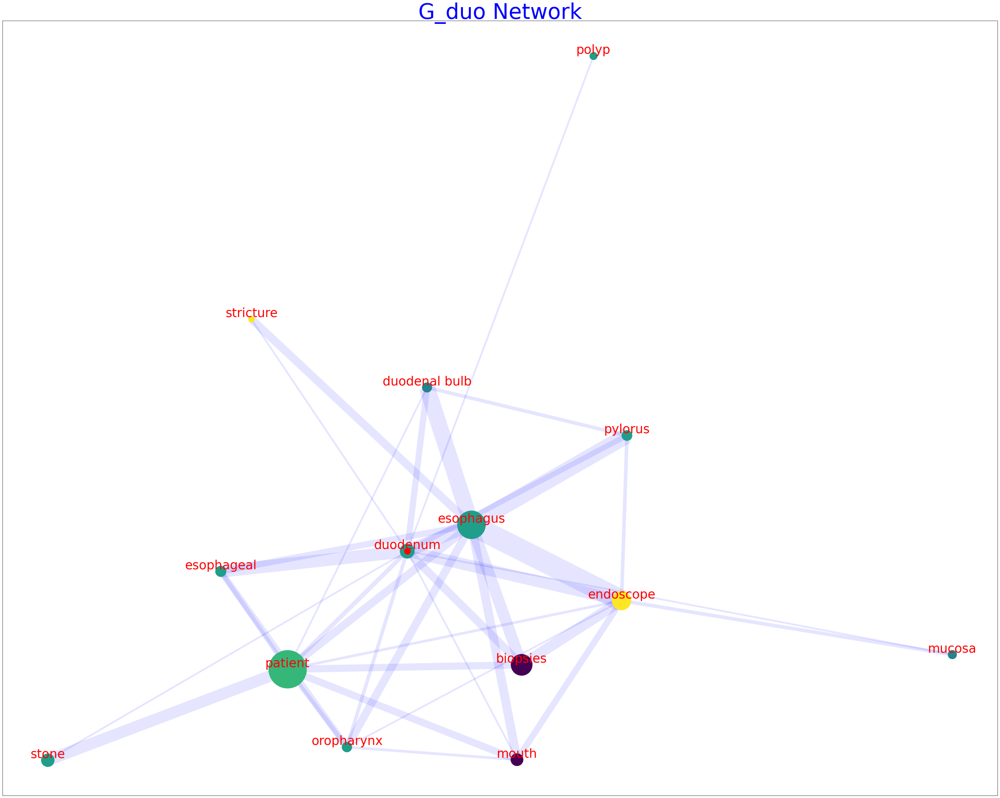

In [398]:
# plot everything in the interest list
for i in range(len(interest_tags)):
    int_tag_name=interest_tags[i]
    int_graph=sub_G_name[i]
    plot_int_tag_graph(int_graph,
                       int_tag_name)